# SYNTHETIC DATA VAULT

Using sdv we will generate synthetic data from a real dataset(credit card default) downloaded from uci repo.
we will use Gaussian Copula method for synthesizing data and try to evaluate our datasets using sdmetrics(e.g KScomplement, CStest etc). We will also create a file with the parameters of our dataset , not any subset of data from real data and can sample instances of data from same distribution of original dataset as many as we want.


In [2]:
import numpy as np
import pandas as pd
import sdv
import matplotlib.pyplot as plt

In [2]:
sdv.__version__

'1.0.0b1'

## DATA LOADING

In [3]:
real_data=pd.read_csv('german_credit_data.csv')
new_data2=pd.read_csv('new_data2.csv')
synthetic_dataCTGAN=pd.read_csv('synthetic_dataCTGAN.csv')
synthetic_dataCTGAN2=pd.read_csv('synthetic_dataCTGAN2.csv')
real_data.head()

,checking_status,duration,credit_history,purpose,credit_amount,savings_status,employment,installment_commitment,personal_status,other_parties,...,property_magnitude,age,other_payment_plans,housing,existing_credits,job,num_dependents,own_telephone,foreign_worker,class
0,<0,6,critical/other existing credit,radio/tv,1169,no known savings,>=7,4,male single,none,...,real estate,67,none,own,2,skilled,1,yes,yes,good
1,0<=X<200,48,existing paid,radio/tv,5951,<100,1<=X<4,2,female div/dep/mar,none,...,real estate,22,none,own,1,skilled,1,none,yes,bad
2,no checking,12,critical/other existing credit,education,2096,<100,4<=X<7,2,male single,none,...,real estate,49,none,own,1,unskilled resident,2,none,yes,good
3,<0,42,existing paid,furniture/equipment,7882,<100,4<=X<7,2,male single,guarantor,...,life insurance,45,none,for free,1,skilled,2,none,yes,good
4,<0,24,delayed previously,new car,4870,<100,1<=X<4,3,male single,none,...,no known property,53,none,for free,2,skilled,2,none,yes,bad


In [4]:
real_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 21 columns):
 #   Column                  Non-Null Count  Dtype 
---  ------                  --------------  ----- 
 0   checking_status         1000 non-null   object
 1   duration                1000 non-null   int64 
 2   credit_history          1000 non-null   object
 3   purpose                 1000 non-null   object
 4   credit_amount           1000 non-null   int64 
 5   savings_status          1000 non-null   object
 6   employment              1000 non-null   object
 7   installment_commitment  1000 non-null   int64 
 8   personal_status         1000 non-null   object
 9   other_parties           1000 non-null   object
 10  residence_since         1000 non-null   int64 
 11  property_magnitude      1000 non-null   object
 12  age                     1000 non-null   int64 
 13  other_payment_plans     1000 non-null   object
 14  housing                 1000 non-null   object
 15  exist

In [5]:
real_data.info()#after changing datatypes

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 21 columns):
 #   Column                  Non-Null Count  Dtype 
---  ------                  --------------  ----- 
 0   checking_status         1000 non-null   object
 1   duration                1000 non-null   int64 
 2   credit_history          1000 non-null   object
 3   purpose                 1000 non-null   object
 4   credit_amount           1000 non-null   int64 
 5   savings_status          1000 non-null   object
 6   employment              1000 non-null   object
 7   installment_commitment  1000 non-null   int64 
 8   personal_status         1000 non-null   object
 9   other_parties           1000 non-null   object
 10  residence_since         1000 non-null   int64 
 11  property_magnitude      1000 non-null   object
 12  age                     1000 non-null   int64 
 13  other_payment_plans     1000 non-null   object
 14  housing                 1000 non-null   object
 15  exist

We need to create metadata for using Gaussian Copula. Metadata contains the information of datasets including primary key and data types of each column.
Also one observation is that there is no missing value in our datasets.

In [5]:
from sdv.metadata import SingleTableMetadata #this is a function that creates metadata, tries to capture the datatypes 
                                              
metadata = SingleTableMetadata()#creating an empty data table
metadata.detect_from_csv(filepath='german_credit_data.csv') 

In [6]:
metadata #checking metadata

{
    "METADATA_SPEC_VERSION": "SINGLE_TABLE_V1",
    "columns": {
        "checking_status": {
            "sdtype": "categorical"
        },
        "duration": {
            "sdtype": "numerical"
        },
        "credit_history": {
            "sdtype": "categorical"
        },
        "purpose": {
            "sdtype": "categorical"
        },
        "credit_amount": {
            "sdtype": "numerical"
        },
        "savings_status": {
            "sdtype": "categorical"
        },
        "employment": {
            "sdtype": "categorical"
        },
        "installment_commitment": {
            "sdtype": "numerical"
        },
        "personal_status": {
            "sdtype": "categorical"
        },
        "other_parties": {
            "sdtype": "categorical"
        },
        "residence_since": {
            "sdtype": "numerical"
        },
        "property_magnitude": {
            "sdtype": "categorical"
        },
        "age": {
            "sdtype": "numer

In [7]:
metadata.validate() #validating for our synthesizer

## SYNTHESIZER(GAUSSIAN COPULA) 

Applying GaussianCopulaSynthesizer with default parametrs

In [9]:
from sdv.single_table import GaussianCopulaSynthesizer

synthesizer1 = GaussianCopulaSynthesizer(metadata)

In [10]:
synthesizer1.fit(real_data) #synthesizer is ready to use


## Genarating Synthetic Data

In [11]:
new_data1= synthesizer1.sample(30000)
new_data1.head()

,checking_status,duration,credit_history,purpose,credit_amount,savings_status,employment,installment_commitment,personal_status,other_parties,...,property_magnitude,age,other_payment_plans,housing,existing_credits,job,num_dependents,own_telephone,foreign_worker,class
0,>=200,16,existing paid,new car,2555,<100,4<=X<7,4,female div/dep/mar,guarantor,...,real estate,32,bank,for free,2,unskilled resident,2,none,no,good
1,<0,8,existing paid,furniture/equipment,1781,500<=X<1000,<1,1,male div/sep,none,...,real estate,31,none,own,2,skilled,2,none,yes,good
2,no checking,10,critical/other existing credit,education,545,<100,4<=X<7,3,male single,none,...,no known property,25,none,own,2,unskilled resident,2,none,yes,bad
3,no checking,17,existing paid,new car,1496,500<=X<1000,unemployed,4,male mar/wid,none,...,real estate,48,bank,for free,2,unskilled resident,2,none,no,good
4,no checking,18,critical/other existing credit,used car,3268,no known savings,1<=X<4,3,male single,none,...,real estate,28,none,own,2,skilled,2,none,yes,good


### Saving Parameters 

In [12]:
synthesizer1.save('my_synthesizer_german_gc.pkl')#saving in a file

We can share this file and load synthetic data from this file. Everytime it'll sythesize different data from the original data
### Loading Data

We can generate this in a different notebook also.

In [13]:
synthesizer = GaussianCopulaSynthesizer.load('my_synthesizer_german_gc.pkl')
diff_data = synthesizer.sample(300)
diff_data.head()

,checking_status,duration,credit_history,purpose,credit_amount,savings_status,employment,installment_commitment,personal_status,other_parties,...,property_magnitude,age,other_payment_plans,housing,existing_credits,job,num_dependents,own_telephone,foreign_worker,class
0,>=200,17,critical/other existing credit,radio/tv,3530,<100,1<=X<4,2,male single,none,...,life insurance,29,none,own,2,unskilled resident,2,none,yes,good
1,>=200,20,no credits/all paid,radio/tv,1389,500<=X<1000,4<=X<7,3,male single,none,...,no known property,33,bank,own,2,unskilled resident,2,none,yes,good
2,no checking,8,critical/other existing credit,radio/tv,1214,no known savings,1<=X<4,4,male div/sep,guarantor,...,car,28,bank,own,2,unskilled resident,2,none,yes,bad
3,no checking,7,existing paid,business,714,no known savings,1<=X<4,4,male single,none,...,life insurance,37,none,own,2,skilled,2,yes,yes,good
4,no checking,25,critical/other existing credit,used car,4326,<100,unemployed,2,male single,none,...,car,33,none,for free,2,high qualif/self emp/mgmt,2,yes,yes,good


## Visualizing Data

We can see that ID generates same types of data as the original dataset.
Rest of them looks good and there is no column from that we can get any information about our original dataset in a high label. Lets compare the statistics of the synthetic and real one

In [14]:
new_data1.columns

Index(['checking_status', 'duration', 'credit_history', 'purpose',
       'credit_amount', 'savings_status', 'employment',
       'installment_commitment', 'personal_status', 'other_parties',
       'residence_since', 'property_magnitude', 'age', 'other_payment_plans',
       'housing', 'existing_credits', 'job', 'num_dependents', 'own_telephone',
       'foreign_worker', 'class'],
      dtype='object')

In [15]:
new_data1.describe(include='all')

,checking_status,duration,credit_history,purpose,credit_amount,savings_status,employment,installment_commitment,personal_status,other_parties,...,property_magnitude,age,other_payment_plans,housing,existing_credits,job,num_dependents,own_telephone,foreign_worker,class
count,30000,30000.000000,30000,30000,30000.000000,30000,30000,30000.000000,30000,30000,...,30000,30000.000000,30000,30000,30000.000000,30000,30000.000000,30000,30000,30000
unique,4,NaN,5,10,NaN,5,5,NaN,4,3,...,4,NaN,3,3,NaN,4,NaN,2,2,2
top,0<=X<200,NaN,critical/other existing credit,radio/tv,NaN,<100,>=7,NaN,male single,none,...,car,NaN,none,own,NaN,skilled,NaN,none,yes,good
freq,9516,NaN,11030,7300,NaN,10985,9440,NaN,15462,24150,...,10415,NaN,22039,16836,NaN,16797,NaN,16602,26199,19090
mean,NaN,21.051733,NaN,NaN,3268.620200,NaN,NaN,2.923867,NaN,NaN,...,NaN,35.594267,NaN,NaN,2.018833,NaN,1.999967,NaN,NaN,NaN
std,NaN,11.880557,NaN,NaN,2529.439863,NaN,NaN,1.111476,NaN,NaN,...,NaN,11.189490,NaN,NaN,0.136672,NaN,0.005774,NaN,NaN,NaN
min,NaN,5.000000,NaN,NaN,250.000000,NaN,NaN,1.000000,NaN,NaN,...,NaN,20.000000,NaN,NaN,2.000000,NaN,1.000000,NaN,NaN,NaN
25%,NaN,12.000000,NaN,NaN,1431.000000,NaN,NaN,2.000000,NaN,NaN,...,NaN,27.000000,NaN,NaN,2.000000,NaN,2.000000,NaN,NaN,NaN
50%,NaN,18.000000,NaN,NaN,2593.500000,NaN,NaN,3.000000,NaN,NaN,...,NaN,33.000000,NaN,NaN,2.000000,NaN,2.000000,NaN,NaN,NaN
75%,NaN,28.000000,NaN,NaN,4377.250000,NaN,NaN,4.000000,NaN,NaN,...,NaN,42.000000,NaN,NaN,2.000000,NaN,2.000000,NaN,NaN,NaN


In [16]:
real_data.describe(include='all')

,checking_status,duration,credit_history,purpose,credit_amount,savings_status,employment,installment_commitment,personal_status,other_parties,...,property_magnitude,age,other_payment_plans,housing,existing_credits,job,num_dependents,own_telephone,foreign_worker,class
count,1000,1000.000000,1000,1000,1000.000000,1000,1000,1000.000000,1000,1000,...,1000,1000.000000,1000,1000,1000.000000,1000,1000.000000,1000,1000,1000
unique,4,NaN,5,10,NaN,5,5,NaN,4,3,...,4,NaN,3,3,NaN,4,NaN,2,2,2
top,no checking,NaN,existing paid,radio/tv,NaN,<100,1<=X<4,NaN,male single,none,...,car,NaN,none,own,NaN,skilled,NaN,none,yes,good
freq,394,NaN,530,280,NaN,603,339,NaN,548,907,...,332,NaN,814,713,NaN,630,NaN,596,963,700
mean,NaN,20.903000,NaN,NaN,3271.258000,NaN,NaN,2.973000,NaN,NaN,...,NaN,35.546000,NaN,NaN,1.407000,NaN,1.155000,NaN,NaN,NaN
std,NaN,12.058814,NaN,NaN,2822.736876,NaN,NaN,1.118715,NaN,NaN,...,NaN,11.375469,NaN,NaN,0.577654,NaN,0.362086,NaN,NaN,NaN
min,NaN,4.000000,NaN,NaN,250.000000,NaN,NaN,1.000000,NaN,NaN,...,NaN,19.000000,NaN,NaN,1.000000,NaN,1.000000,NaN,NaN,NaN
25%,NaN,12.000000,NaN,NaN,1365.500000,NaN,NaN,2.000000,NaN,NaN,...,NaN,27.000000,NaN,NaN,1.000000,NaN,1.000000,NaN,NaN,NaN
50%,NaN,18.000000,NaN,NaN,2319.500000,NaN,NaN,3.000000,NaN,NaN,...,NaN,33.000000,NaN,NaN,1.000000,NaN,1.000000,NaN,NaN,NaN
75%,NaN,24.000000,NaN,NaN,3972.250000,NaN,NaN,4.000000,NaN,NaN,...,NaN,42.000000,NaN,NaN,2.000000,NaN,1.000000,NaN,NaN,NaN


## Evaluating Synthetic Data

In [17]:
from sdv.evaluation.single_table import evaluate_quality

quality_report1 = evaluate_quality(
    real_data,
    new_data1,
    metadata
)

Creating report: 100%|███████████████████████████████████████████████████████████████████| 4/4 [00:04<00:00,  1.06s/it]



Overall Quality Score: 78.61%

Properties:
Column Shapes: 82.87%
Column Pair Trends: 74.34%


In [18]:
quality_report1.get_details(property_name='Column Shapes')

,Column,Metric,Quality Score
0,duration,KSComplement,0.906100
1,credit_amount,KSComplement,0.937300
2,installment_commitment,KSComplement,0.949567
3,residence_since,KSComplement,0.927900
4,age,KSComplement,0.978633
5,existing_credits,KSComplement,0.367000
6,num_dependents,KSComplement,0.155033
7,checking_status,TVComplement,0.862667
8,credit_history,TVComplement,0.812233
9,purpose,TVComplement,0.798767


In [19]:
fig=quality_report1.get_visualization(property_name='Column Shapes')
fig.show()

In [20]:
fig = quality_report1.get_visualization(property_name='Column Pair Trends')
fig.show()

In [21]:
from sdv.evaluation.single_table import get_column_plot

fig = get_column_plot(
    real_data=real_data,
    synthetic_data=new_data1,
    column_name='num_dependents',
    metadata=metadata
)
    
fig.show()

They don't match at al and most probably our synthesizer does not catch the distribution of BILL_AMT1

In [22]:
fig = get_column_plot(
    real_data=real_data,
    synthetic_data=new_data1,
    column_name='existing_credits',
    metadata=metadata
)
    
fig.show()

distribution looks similar but the range for synthetic data is much bigger than the real data

In [23]:
fig = get_column_plot(
    real_data=real_data,
    synthetic_data=new_data1,
    column_name='savings_status',
    metadata=metadata
)
    
fig.show()

In [24]:
fig = get_column_plot(
    real_data=real_data,
    synthetic_data=new_data1,
    column_name='purpose',
    metadata=metadata
)
    
fig.show()

In [25]:
fig = get_column_plot(
    real_data=real_data,
    synthetic_data=new_data1,
    column_name='housing',
    metadata=metadata
)
    
fig.show()

In [26]:
fig = get_column_plot(
    real_data=real_data,
    synthetic_data=new_data1,
    column_name='age',
    metadata=metadata
)
    
fig.show()

In [27]:
from sdv.evaluation.single_table import get_column_pair_plot

fig = get_column_pair_plot(
    real_data=real_data,
    synthetic_data=new_data1,
    column_names=['housing','num_dependents'],
    metadata=metadata
)
    
fig.show()

In [28]:
from sdv.evaluation.single_table import get_column_pair_plot

fig = get_column_pair_plot(
    real_data=real_data,
    synthetic_data=new_data1,
    column_names=[ 'purpose','num_dependents'],
    metadata=metadata
)
    
fig.show()

## CUSTOMIZATION

Let's try to improve our data by using some customization tool for gaussian copula method. First check the transformer method and distribution used for each column 

In [29]:
#used for transforming datatypes to cont. var
transformers = synthesizer1.get_transformers()
transformers

{'checking_status': LabelEncoder(add_noise=True),
 'duration': FloatFormatter(learn_rounding_scheme=True, enforce_min_max_values=True),
 'credit_history': LabelEncoder(add_noise=True),
 'purpose': LabelEncoder(add_noise=True),
 'credit_amount': FloatFormatter(learn_rounding_scheme=True, enforce_min_max_values=True),
 'savings_status': LabelEncoder(add_noise=True),
 'employment': LabelEncoder(add_noise=True),
 'installment_commitment': FloatFormatter(learn_rounding_scheme=True, enforce_min_max_values=True),
 'personal_status': LabelEncoder(add_noise=True),
 'other_parties': LabelEncoder(add_noise=True),
 'residence_since': FloatFormatter(learn_rounding_scheme=True, enforce_min_max_values=True),
 'property_magnitude': LabelEncoder(add_noise=True),
 'age': FloatFormatter(learn_rounding_scheme=True, enforce_min_max_values=True),
 'other_payment_plans': LabelEncoder(add_noise=True),
 'housing': LabelEncoder(add_noise=True),
 'existing_credits': FloatFormatter(learn_rounding_scheme=True, enf

In [30]:
synthesizer1.get_learned_distributions()

{'checking_status': {'distribution': 'beta',
  'learned_parameters': {'loc': -0.011432404916845227,
   'scale': 4.023383640843755,
   'a': 1.238967374165845,
   'b': 1.661897861580827}},
 'duration': {'distribution': 'beta',
  'learned_parameters': {'loc': 4.986868700699361,
   'scale': 84.69927176156521,
   'a': 1.2894457226926288,
   'b': 5.51002868517816}},
 'credit_history': {'distribution': 'beta',
  'learned_parameters': {'loc': -0.08488585307044141,
   'scale': 22.51657516936763,
   'a': 2.143023821009794,
   'b': 27.85926266203807}},
 'purpose': {'distribution': 'beta',
  'learned_parameters': {'loc': 0.002646195083407687,
   'scale': 10.614114847121378,
   'a': 0.9577228842619359,
   'b': 2.6039707485119212}},
 'credit_amount': {'distribution': 'beta',
  'learned_parameters': {'loc': 246.71859019870692,
   'scale': 66109805930397.0,
   'a': 1.441019446569752,
   'b': 31536965670.45149}},
 'savings_status': {'distribution': 'beta',
  'learned_parameters': {'loc': -0.21746066956

Lets check the parametrs used 

In [31]:
synthesizer1.get_parameters()

{'enforce_min_max_values': True,
 'enforce_rounding': True,
 'numerical_distributions': {},
 'default_distribution': 'beta'}

In [32]:
synthesizer2 = GaussianCopulaSynthesizer(
    metadata, # required
    enforce_min_max_values=True,
    enforce_rounding=True,
    numerical_distributions = {
    'num_dependents': 'truncnorm',
    'existing_credits' : 'truncnorm',
         'housing' : 'gamma',
    'purpose': 'truncnorm',
        'savings_status': 'truncnorm'
    },
    default_distribution='beta'
)

In [33]:
synthesizer2.get_parameters()

{'enforce_min_max_values': True,
 'enforce_rounding': True,
 'numerical_distributions': {'num_dependents': 'truncnorm',
  'existing_credits': 'truncnorm',
  'housing': 'gamma',
  'purpose': 'truncnorm',
  'savings_status': 'truncnorm'},
 'default_distribution': 'beta'}

In [34]:
synthesizer2.fit(real_data)
new_data2=synthesizer2.sample(30000)

In [12]:
new_data2.head()

,checking_status,duration,credit_history,purpose,credit_amount,savings_status,employment,installment_commitment,personal_status,other_parties,...,property_magnitude,age,other_payment_plans,housing,existing_credits,job,num_dependents,own_telephone,foreign_worker,class
0,0<=X<200,10,critical/other existing credit,education,1789,<100,4<=X<7,4,male div/sep,none,...,car,42,bank,own,1,high qualif/self emp/mgmt,1,none,no,bad
1,0<=X<200,12,existing paid,used car,1739,>=1000,<1,1,female div/dep/mar,none,...,real estate,30,none,own,1,unskilled resident,2,none,yes,good
2,>=200,11,critical/other existing credit,furniture/equipment,568,<100,unemployed,3,female div/dep/mar,none,...,real estate,30,none,own,2,skilled,1,yes,yes,bad
3,<0,8,existing paid,furniture/equipment,1230,500<=X<1000,unemployed,4,male div/sep,guarantor,...,car,55,none,for free,1,high qualif/self emp/mgmt,1,none,no,bad
4,0<=X<200,8,critical/other existing credit,furniture/equipment,2817,no known savings,4<=X<7,1,female div/dep/mar,none,...,car,42,none,own,2,skilled,1,yes,yes,good


In [10]:
new_data2.describe(include='all')

,Unnamed: 0,checking_status,duration,credit_history,purpose,credit_amount,savings_status,employment,installment_commitment,personal_status,...,property_magnitude,age,other_payment_plans,housing,existing_credits,job,num_dependents,own_telephone,foreign_worker,class
count,30000.000000,30000,30000.000000,30000,30000,30000.000000,30000,30000,30000.000000,30000,...,30000,30000.000000,30000,30000,30000.000000,30000,30000.000000,30000,30000,30000
unique,NaN,4,NaN,5,10,NaN,5,5,NaN,4,...,4,NaN,3,3,NaN,4,NaN,2,2,2
top,NaN,0<=X<200,NaN,existing paid,radio/tv,NaN,no known savings,>=7,NaN,male single,...,car,NaN,none,own,NaN,skilled,NaN,none,yes,good
freq,NaN,9504,NaN,10929,6084,NaN,9103,9546,NaN,15516,...,10517,NaN,22059,19204,NaN,16592,NaN,16785,26240,19085
mean,14999.500000,NaN,21.075600,NaN,NaN,3265.247633,NaN,NaN,2.928333,NaN,...,NaN,35.542133,NaN,NaN,1.517367,NaN,1.220567,NaN,NaN,NaN
std,8660.398374,NaN,11.896013,NaN,NaN,2529.624452,NaN,NaN,1.107477,NaN,...,NaN,11.120834,NaN,NaN,0.564720,NaN,0.414636,NaN,NaN,NaN
min,0.000000,NaN,5.000000,NaN,NaN,250.000000,NaN,NaN,1.000000,NaN,...,NaN,20.000000,NaN,NaN,1.000000,NaN,1.000000,NaN,NaN,NaN
25%,7499.750000,NaN,12.000000,NaN,NaN,1425.000000,NaN,NaN,2.000000,NaN,...,NaN,27.000000,NaN,NaN,1.000000,NaN,1.000000,NaN,NaN,NaN
50%,14999.500000,NaN,18.000000,NaN,NaN,2597.000000,NaN,NaN,3.000000,NaN,...,NaN,33.000000,NaN,NaN,1.000000,NaN,1.000000,NaN,NaN,NaN
75%,22499.250000,NaN,28.000000,NaN,NaN,4385.250000,NaN,NaN,4.000000,NaN,...,NaN,42.000000,NaN,NaN,2.000000,NaN,1.000000,NaN,NaN,NaN


In [11]:
new_data2=new_data2.drop('Unnamed: 0',axis=1)

In [13]:
#gaussian_copula
from sdv.evaluation.single_table import evaluate_quality
quality_report2 = evaluate_quality(
    real_data,
    new_data2,
    metadata
)

Creating report: 100%|███████████████████████████████████████████████████████████████████| 4/4 [00:03<00:00,  1.11it/s]



Overall Quality Score: 85.47%

Properties:
Column Shapes: 89.03%
Column Pair Trends: 81.9%


In [38]:
rpt_gc=quality_report2.get_details('Column Shapes')
rpt_gc

,Column,Metric,Quality Score
0,duration,KSComplement,0.900233
1,credit_amount,KSComplement,0.939000
2,installment_commitment,KSComplement,0.951000
3,residence_since,KSComplement,0.927133
4,age,KSComplement,0.977800
5,existing_credits,KSComplement,0.883900
6,num_dependents,KSComplement,0.934433
7,checking_status,TVComplement,0.859067
8,credit_history,TVComplement,0.812833
9,purpose,TVComplement,0.803333


In [39]:
fig=quality_report2.get_visualization(property_name='Column Shapes')
fig.show()

In [14]:
fig=quality_report2.get_visualization(property_name='Column Pair Trends')
fig.show()

In [41]:
from sdv.evaluation.single_table import get_column_plot

fig = get_column_plot(
    real_data=real_data,
    synthetic_data=new_data2,
    column_name='num_dependents',
    metadata=metadata
)
    
fig.show()

In [42]:
from sdv.evaluation.single_table import get_column_plot

fig = get_column_plot(
    real_data=real_data,
    synthetic_data=new_data2,
    column_name='savings_status',
    metadata=metadata
)
    
fig.show()

So the shape looks improved.

In [43]:
from sdv.evaluation.single_table import get_column_pair_plot

fig = get_column_pair_plot(
    real_data=real_data,
    synthetic_data=new_data1,
    column_names=['savings_status','num_dependents',],
    metadata=metadata
)
    
fig.show()

In [44]:
fig = get_column_plot(
    real_data=real_data,
    synthetic_data=new_data2,
    column_name='existing_credits',
    metadata=metadata
)
    
fig.show()

In [45]:
fig = get_column_plot(
    real_data=real_data,
    synthetic_data=new_data2,
    column_name='credit_amount',
    metadata=metadata
)
    
fig.show()

## DIAGNOSTIC:

In [46]:
from sdmetrics.reports.single_table import DiagnosticReport

report2 = DiagnosticReport()

In [47]:
report2.generate(real_data, new_data2,metadata)

Creating report: 100%|███████████████████████████████████████████████████████████████████| 4/4 [00:30<00:00,  7.63s/it]


DiagnosticResults:

SUCCESS:
✓ The synthetic data covers over 90% of the numerical ranges present in the real data
✓ The synthetic data covers over 90% of the categories present in the real data
✓ Over 90% of the synthetic rows are not copies of the real data
✓ The synthetic data follows over 90% of the min/max boundaries set by the real data


In [48]:
report2.get_properties()

{'Coverage': 0.9984493797519007, 'Synthesis': 1.0, 'Boundaries': 1.0}

Synthesis: Is the synthetic data unique or does it copy the real rows?

Coverage: This metric measures whether a synthetic column covers the full range of values that are present in a real column.

Boundaries: This metrics measures whether a synthetic column respects the minimum and maximum values of the real column. It returns the percentage of synthetic rows that adhere to the real boundaries.

In [49]:
report2.get_details(property_name='Coverage')

,Column,Metric,Diagnostic Score
0,duration,RangeCoverage,0.985294
1,credit_amount,RangeCoverage,1.000000
2,installment_commitment,RangeCoverage,1.000000
3,residence_since,RangeCoverage,1.000000
4,age,RangeCoverage,0.982143
5,existing_credits,RangeCoverage,1.000000
6,num_dependents,RangeCoverage,1.000000
7,checking_status,CategoryCoverage,1.000000
8,credit_history,CategoryCoverage,1.000000
9,purpose,CategoryCoverage,1.000000


In [50]:
fig = report2.get_visualization(property_name='Coverage')
fig.show()

## LIKELIHOOD:

In [51]:
from sdmetrics.single_table import GMLogLikelihood

GMLogLikelihood.compute(
    real_data=real_data,
    synthetic_data=new_data2
)

-683.8008912564537

GMLikelihood:Data Likelihood describes a set of metrics that calculate the likelihood of the synthetic data belonging to the real data. This metric uses Gaussian Mixture Models to make this calculation.

This metric fits multiple Gaussian mixture models  to learn the distribution of the real data. The model learns to produce a likelihood estimate for every row ranging from -∞ to to +∞, where -∞ means the row is likely not part of the data and +∞ means that it is.

## ML EFFICIENCY:

In [52]:
from sdmetrics.single_table import BinaryAdaBoostClassifier, BinaryDecisionTreeClassifier, BinaryLogisticRegression, BinaryMLPClassifier    



BinaryLogisticRegression.compute(
    test_data=real_data,
    train_data=new_data2,
    target='class',
    metadata=metadata
)

0.7635542168674698

## DETECTION

In [53]:
from sdmetrics.single_table import LogisticDetection

LogisticDetection.compute(
    real_data=real_data,
    synthetic_data=new_data2,
    metadata=metadata
)

0.3294605845366322

Tabular Detection describes a set of metrics that calculate how difficult it is to tell apart the real data from the synthetic data. 
This is done using a machine learning model. There are two different Detection metrics that use different ML algorithms: LogisticDetection and SVCDetection.

## PRIVACY

In [54]:
from sdmetrics.single_table import CategoricalZeroCAP

score = CategoricalZeroCAP.compute(
    real_data=real_data,
    synthetic_data=new_data2,
    key_fields=['purpose', 'class','personal_status'],
    sensitive_fields=['property_magnitude'])
score

0.7320580958806717

The CategoricalCAP measures the risk of disclosing sensitive information through an inference attack. We assume that some values in the real data are public knowledge. An attacker is combining this with synthetic data to make guesses about other real values that are sensitive.

CategoricalZeroCAP: If there are no rows in the equivalence class, then the attacker records a failure (0) to guess that row

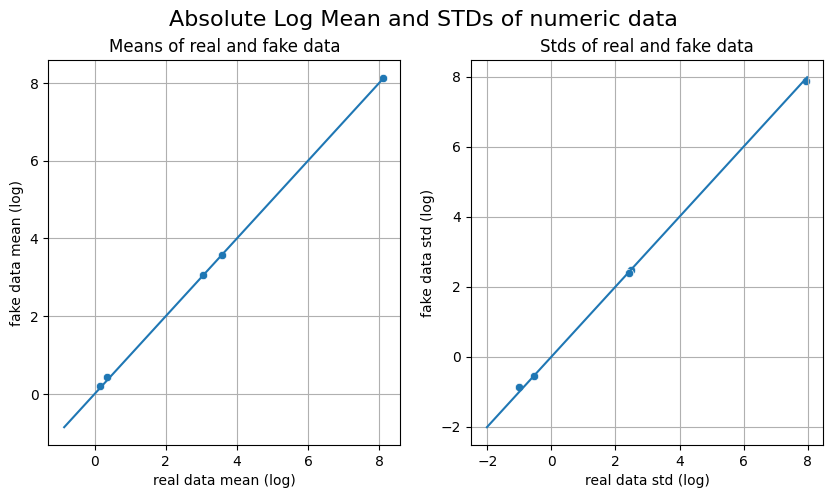

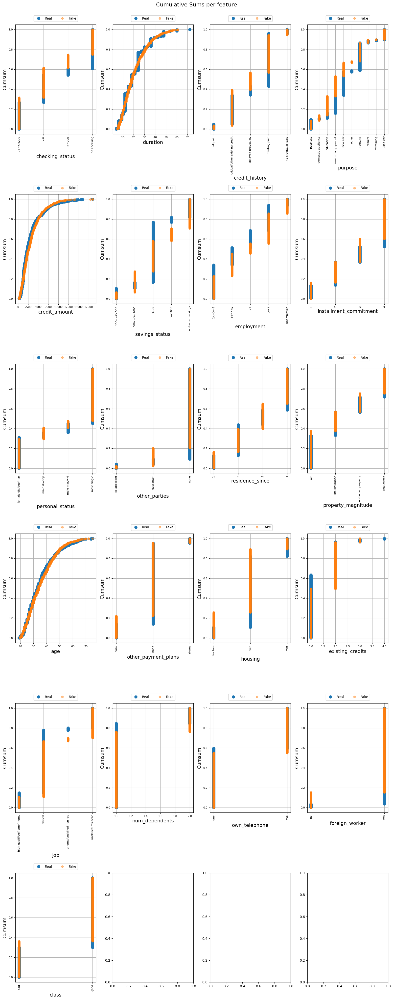

C:\Users\arnab\AppData\Local\Programs\Python\Python310\lib\site-packages\table_evaluator\table_evaluator.py:156: FutureWarning:

The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\arnab\AppData\Local\Programs\Python\Python310\lib\site-packages\table_evaluator\table_evaluator.py:156: FutureWarning:

The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\arnab\AppData\Local\Programs\Python\Python310\lib\site-packages\table_evaluator\table_evaluator.py:156: FutureWarning:

The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\arnab\AppData\Local\Programs\Python\Python310\lib\site-packages\table_evaluator\table_evaluator.py:156: FutureWarning:

The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\U

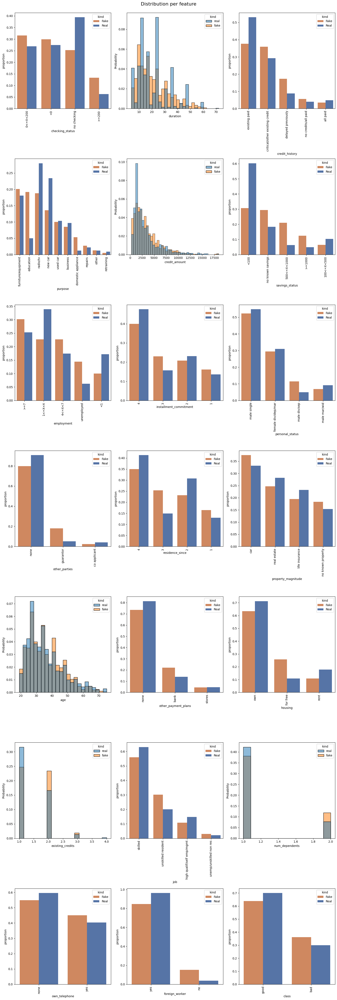

TypeError: Image data of dtype object cannot be converted to float

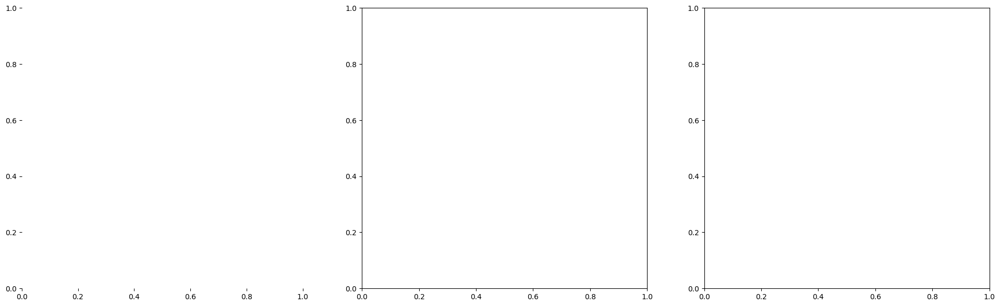

In [192]:
from table_evaluator import TableEvaluator
table_evaluator1 = TableEvaluator(real_data, new_data2, cat_cols=cat_cols)
table_evaluator1.visual_evaluation()

## CTGAN

## CTGAN

In [70]:
from sdv.single_table import CTGANSynthesizer

synthesizer2 = CTGANSynthesizer(metadata,
    verbose=True)
synthesizer2.fit(real_data)

synthetic_dataCTGAN = synthesizer2.sample(num_rows=30000)

Epoch 1, Loss G:  1.2879,Loss D: -0.0408
Epoch 2, Loss G:  1.3076,Loss D: -0.1116
Epoch 3, Loss G:  1.2780,Loss D: -0.1833
Epoch 4, Loss G:  1.2353,Loss D: -0.2076
Epoch 5, Loss G:  1.2186,Loss D: -0.3330
Epoch 6, Loss G:  1.0276,Loss D: -0.4163
Epoch 7, Loss G:  0.9160,Loss D: -0.5555
Epoch 8, Loss G:  0.7171,Loss D: -0.5285
Epoch 9, Loss G:  0.6070,Loss D: -0.5670
Epoch 10, Loss G:  0.2126,Loss D: -0.5417
Epoch 11, Loss G: -0.0022,Loss D: -0.4029
Epoch 12, Loss G: -0.2261,Loss D: -0.1762
Epoch 13, Loss G: -0.3805,Loss D:  0.0018
Epoch 14, Loss G: -0.4936,Loss D:  0.1346
Epoch 15, Loss G: -0.5560,Loss D:  0.2619
Epoch 16, Loss G: -0.5214,Loss D:  0.1742
Epoch 17, Loss G: -0.4914,Loss D:  0.2951
Epoch 18, Loss G: -0.3596,Loss D:  0.1215
Epoch 19, Loss G: -0.2887,Loss D:  0.1128
Epoch 20, Loss G: -0.3085,Loss D:  0.1567
Epoch 21, Loss G: -0.0965,Loss D: -0.0290
Epoch 22, Loss G: -0.3332,Loss D:  0.2504
Epoch 23, Loss G: -0.1858,Loss D:  0.0788
Epoch 24, Loss G: -0.1800,Loss D:  0.1588
E

Epoch 195, Loss G: -1.8717,Loss D: -0.1823
Epoch 196, Loss G: -1.9327,Loss D:  0.1441
Epoch 197, Loss G: -2.0487,Loss D: -0.0711
Epoch 198, Loss G: -2.0046,Loss D:  0.0621
Epoch 199, Loss G: -2.0014,Loss D:  0.0278
Epoch 200, Loss G: -1.8855,Loss D:  0.1014
Epoch 201, Loss G: -1.8414,Loss D:  0.0490
Epoch 202, Loss G: -1.6943,Loss D: -0.2515
Epoch 203, Loss G: -1.8091,Loss D: -0.0824
Epoch 204, Loss G: -1.9173,Loss D: -0.1251
Epoch 205, Loss G: -1.7750,Loss D: -0.0767
Epoch 206, Loss G: -1.8785,Loss D: -0.0867
Epoch 207, Loss G: -1.9202,Loss D:  0.0718
Epoch 208, Loss G: -2.0625,Loss D: -0.2361
Epoch 209, Loss G: -2.0046,Loss D: -0.0391
Epoch 210, Loss G: -2.0185,Loss D: -0.0815
Epoch 211, Loss G: -1.9091,Loss D: -0.0541
Epoch 212, Loss G: -1.9612,Loss D:  0.0260
Epoch 213, Loss G: -1.9529,Loss D:  0.0825
Epoch 214, Loss G: -2.0095,Loss D:  0.0702
Epoch 215, Loss G: -1.9867,Loss D:  0.0905
Epoch 216, Loss G: -1.9436,Loss D:  0.2076
Epoch 217, Loss G: -1.9801,Loss D:  0.1220
Epoch 218, 

In [71]:
synthetic_dataCTGAN.head()

,checking_status,duration,credit_history,purpose,credit_amount,savings_status,employment,installment_commitment,personal_status,other_parties,...,property_magnitude,age,other_payment_plans,housing,existing_credits,job,num_dependents,own_telephone,foreign_worker,class
0,<0,39,existing paid,furniture/equipment,2803,100<=X<500,4<=X<7,3,male mar/wid,none,...,car,31,none,own,2,unemp/unskilled non res,2,yes,yes,bad
1,0<=X<200,36,existing paid,education,2901,<100,1<=X<4,2,male single,none,...,car,38,stores,rent,1,high qualif/self emp/mgmt,1,none,yes,bad
2,no checking,22,no credits/all paid,furniture/equipment,1350,<100,>=7,4,male single,none,...,car,36,none,own,1,skilled,1,none,yes,bad
3,<0,22,critical/other existing credit,radio/tv,3291,<100,>=7,4,male single,none,...,life insurance,37,none,rent,2,unskilled resident,1,none,yes,good
4,<0,19,existing paid,furniture/equipment,3852,<100,>=7,4,female div/dep/mar,none,...,life insurance,25,none,own,1,high qualif/self emp/mgmt,2,yes,yes,good


In [72]:
synthesizer.save('my_synthesizer_german_ct.pkl')#saving in a file

In [73]:
quality_report2 = evaluate_quality(
    real_data,
    synthetic_dataCTGAN,
    metadata
)

Creating report: 100%|███████████████████████████████████████████████████████████████████| 4/4 [00:03<00:00,  1.12it/s]



Overall Quality Score: 86.78%

Properties:
Column Shapes: 89.14%
Column Pair Trends: 84.42%


In [74]:
fig=quality_report2.get_visualization(property_name='Column Shapes')
fig.show()

In [75]:
rpt_gan=quality_report2.get_details('Column Shapes')
rpt_gan

,Column,Metric,Quality Score
0,duration,KSComplement,0.739400
1,credit_amount,KSComplement,0.816167
2,installment_commitment,KSComplement,0.856100
3,residence_since,KSComplement,0.872200
4,age,KSComplement,0.776167
5,existing_credits,KSComplement,0.786033
6,num_dependents,KSComplement,0.889933
7,checking_status,TVComplement,0.944100
8,credit_history,TVComplement,0.952667
9,purpose,TVComplement,0.949100


In [76]:
from sdv.evaluation.single_table import get_column_plot

fig = get_column_plot(
    real_data=real_data,
    synthetic_data=synthetic_dataCTGAN,
    column_name='num_dependents',
    metadata=metadata
)
    
fig.show()

In [77]:

fig = get_column_plot(
    real_data=real_data,
    synthetic_data=synthetic_dataCTGAN,
    column_name='age',
    metadata=metadata
)
    
fig.show()

In [78]:
fig = get_column_plot(
    real_data=real_data,
    synthetic_data=synthetic_dataCTGAN,
    column_name='credit_amount',
    metadata=metadata
)
    
fig.show()

In [79]:
fig = get_column_plot(
    real_data=real_data,
    synthetic_data=synthetic_dataCTGAN,
    column_name='installment_commitment',
    metadata=metadata
)
    
fig.show()

In [80]:
from sdv.evaluation.single_table import get_column_plot

fig = get_column_plot(
    real_data=real_data,
    synthetic_data=synthetic_dataCTGAN,
    column_name='savings_status',
    metadata=metadata
)
    
fig.show()

In [81]:
fig = get_column_plot(
    real_data=real_data,
    synthetic_data=synthetic_dataCTGAN,
    column_name='existing_credits',
    metadata=metadata
)
    
fig.show()

In [82]:
fig=quality_report2.get_visualization(property_name='Column Pair Trends')
fig.show()

In [83]:
from sdmetrics.reports.single_table import DiagnosticReport

report3 = DiagnosticReport()

In [84]:
report3.generate(real_data,synthetic_dataCTGAN ,metadata)

Creating report: 100%|███████████████████████████████████████████████████████████████████| 4/4 [00:20<00:00,  5.16s/it]


DiagnosticResults:

SUCCESS:
✓ The synthetic data covers over 90% of the numerical ranges present in the real data
✓ The synthetic data covers over 90% of the categories present in the real data
✓ Over 90% of the synthetic rows are not copies of the real data
✓ The synthetic data follows over 90% of the min/max boundaries set by the real data


In [85]:
report3.get_properties()

{'Coverage': 1.0, 'Synthesis': 1.0, 'Boundaries': 1.0}

In [ ]:
from sdmetrics.single_table import GMLogLikelihood

GMLogLikelihood.compute(
    real_data=real_data,
    synthetic_data=synthetic_dataCTGAN
)

In [ ]:
#DETECTION
from sdmetrics.single_table import LogisticDetection

LogisticDetection.compute(
    real_data=real_data,
    synthetic_data=synthetic_dataCTGAN,
    metadata=metadata
)

In [86]:
from sdmetrics.single_table import BinaryAdaBoostClassifier, BinaryDecisionTreeClassifier, BinaryLogisticRegression, BinaryMLPClassifier    

#MLEFFICACY
BinaryLogisticRegression.compute(
    test_data=real_data,
    train_data=synthetic_dataCTGAN,
    target='class',
    metadata=metadata
)

0.6875477463712757

In [ ]:
#PRIVACY
from sdmetrics.single_table import CategoricalZeroCAP
score = CategoricalZeroCAP.compute(
    real_data=real_data,
    synthetic_data=synthetic_dataCTGAN,
    key_fields=['purpose', 'class','personal_status'],
    sensitive_fields=['property_magnitude'])
score

## NEW EVALUATION 

In [ ]:
pip install table_evaluator

In [87]:
real_data.columns

Index(['checking_status', 'duration', 'credit_history', 'purpose',
       'credit_amount', 'savings_status', 'employment',
       'installment_commitment', 'personal_status', 'other_parties',
       'residence_since', 'property_magnitude', 'age', 'other_payment_plans',
       'housing', 'existing_credits', 'job', 'num_dependents', 'own_telephone',
       'foreign_worker', 'class'],
      dtype='object')

In [88]:
cat_cols=['checking_status','credit_history', 'purpose',
        'savings_status', 'employment','personal_status', 'other_parties', 'property_magnitude', 'other_payment_plans',
       'housing', 'job',  'own_telephone',
       'foreign_worker', 'class','installment_commitment','residence_since']

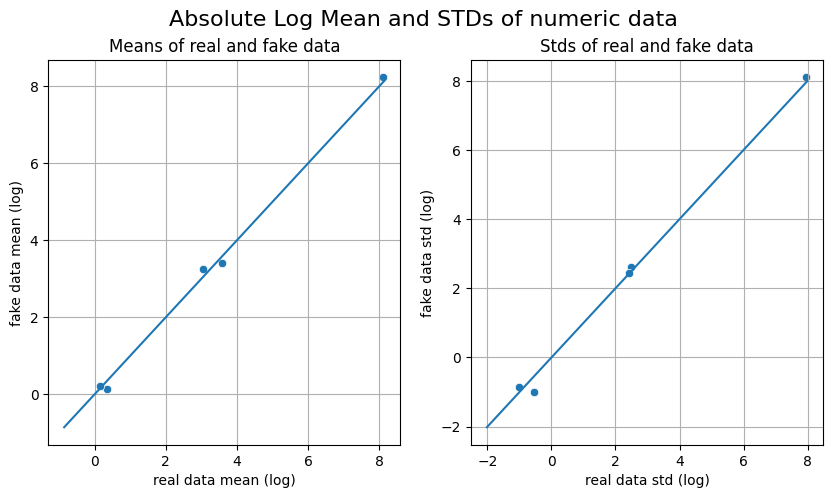

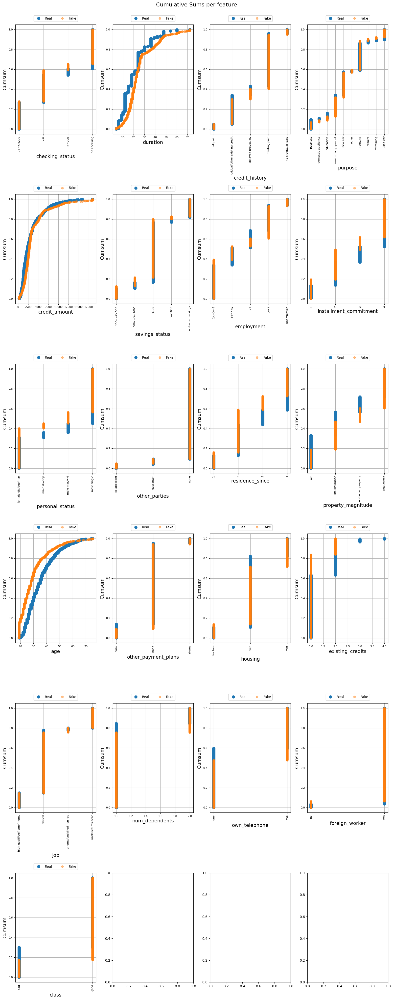

C:\Users\arnab\AppData\Local\Programs\Python\Python310\lib\site-packages\table_evaluator\table_evaluator.py:156: FutureWarning:

The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\arnab\AppData\Local\Programs\Python\Python310\lib\site-packages\table_evaluator\table_evaluator.py:156: FutureWarning:

The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\arnab\AppData\Local\Programs\Python\Python310\lib\site-packages\table_evaluator\table_evaluator.py:156: FutureWarning:

The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\arnab\AppData\Local\Programs\Python\Python310\lib\site-packages\table_evaluator\table_evaluator.py:156: FutureWarning:

The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\U

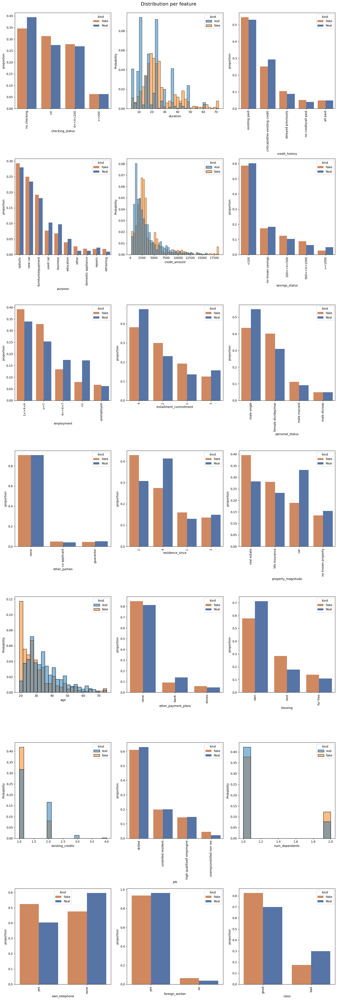

TypeError: Image data of dtype object cannot be converted to float

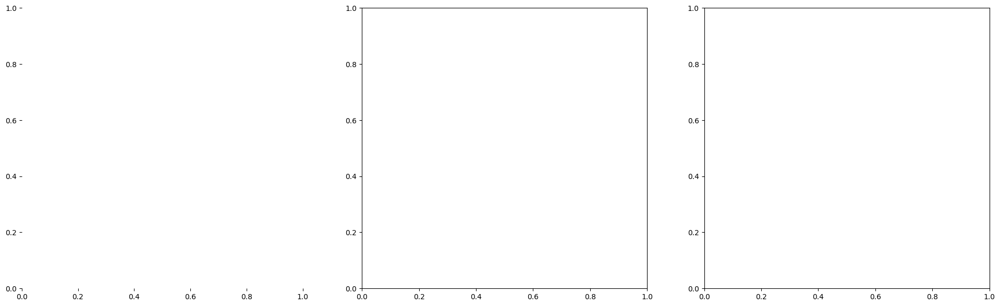

In [89]:
from table_evaluator import TableEvaluator
table_evaluator1 = TableEvaluator(real_data, synthetic_dataCTGAN, cat_cols=cat_cols)
table_evaluator1.visual_evaluation()

# CTGAN with customization

In [ ]:
from sdv.single_table import CTGANSynthesizer

synthesizer2 = CTGANSynthesizer(metadata, # required
    enforce_rounding=False,
    epochs=600,
    verbose=True)


In [ ]:
synthesizer2.fit(real_data)
synthetic_dataCTGAN2 = synthesizer2.sample(num_rows=30000)

In [ ]:
synthetic_dataCTGAN2.head()

In [ ]:
synthesizer2.save('my_synthesizer_german_ct2.pkl')#saving in a file

In [ ]:
quality_report3 = evaluate_quality(
    real_data,
    synthetic_dataCTGAN2,
    metadata
)

In [ ]:
fig=quality_report3.get_visualization(property_name='Column Shapes')
fig.show()

In [ ]:
rpt_gan2=quality_report3.get_details('Column Shapes')
rpt_gan2

In [ ]:
from table_evaluator import TableEvaluator
table_evaluator = TableEvaluator(real_data, synthetic_dataCTGAN2, cat_cols=cat_cols)
table_evaluator.visual_evaluation()

In [ ]:
fig=quality_report3.get_visualization(property_name='Column Pair Trends')
fig.show()

In [ ]:
#COLUMN PAIR TRENDS


In [ ]:
from table_evaluator import TableEvaluator
table_evaluator = TableEvaluator(real_data, new_data2, cat_cols=cat_cols)
table_evaluator.visual_evaluation()

## MERGING TWO TYPES OF DATASETS: 

In [131]:
col=['residence_since','credit_amount','existing_credits','duration','age','installment_commitment']

In [132]:
col


['residence_since',
 'credit_amount',
 'existing_credits',
 'duration',
 'age',
 'installment_commitment']

In [133]:
rpt_gan['Quality Score_gc']=rpt_gc['Quality Score']

In [134]:
rpt_gan

,Column,Metric,Quality Score,Quality Score_gc
0,duration,KSComplement,0.739400,0.900233
1,credit_amount,KSComplement,0.816167,0.939000
2,installment_commitment,KSComplement,0.856100,0.951000
3,residence_since,KSComplement,0.872200,0.927133
4,age,KSComplement,0.776167,0.977800
5,existing_credits,KSComplement,0.786033,0.883900
6,num_dependents,KSComplement,0.889933,0.934433
7,checking_status,TVComplement,0.944100,0.859067
8,credit_history,TVComplement,0.952667,0.812833
9,purpose,TVComplement,0.949100,0.803333


In [135]:
df=synthetic_dataCTGAN
df1=new_data2
for i in col:
     if rpt_gan.loc[rpt_gan['Column']==i, 'Quality Score_gc'].values[0] > rpt_gan.loc[rpt_gan['Column']==i, 'Quality Score'].values[0]:
        df=df.sort_values(by=[i])
        df1=df1.sort_values(by=[i])
        df[i]=df1[i]
df    

,checking_status,duration,credit_history,purpose,credit_amount,savings_status,employment,installment_commitment,personal_status,other_parties,...,property_magnitude,age,other_payment_plans,housing,existing_credits,job,num_dependents,own_telephone,foreign_worker,class
20276,no checking,9,existing paid,radio/tv,652,<100,1<=X<4,3,female div/dep/mar,none,...,car,35,none,own,2,unskilled resident,1,yes,yes,good
11244,no checking,13,existing paid,retraining,483,<100,>=7,2,male single,none,...,real estate,48,none,own,1,skilled,1,yes,yes,bad
22030,0<=X<200,17,all paid,radio/tv,2247,500<=X<1000,4<=X<7,2,female div/dep/mar,none,...,car,24,none,own,2,skilled,1,yes,yes,good
19698,no checking,32,existing paid,radio/tv,1335,no known savings,1<=X<4,4,male single,none,...,real estate,24,none,for free,1,unskilled resident,1,none,yes,good
25031,<0,7,existing paid,radio/tv,2736,<100,unemployed,2,female div/dep/mar,none,...,car,52,none,own,2,high qualif/self emp/mgmt,1,yes,yes,good
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10741,<0,31,existing paid,furniture/equipment,587,100<=X<500,unemployed,4,female div/dep/mar,none,...,car,22,none,own,1,skilled,1,none,no,good
2016,0<=X<200,19,delayed previously,new car,4341,<100,>=7,3,male single,none,...,no known property,48,none,rent,2,skilled,1,yes,yes,good
27698,no checking,28,existing paid,new car,5063,<100,1<=X<4,1,female div/dep/mar,none,...,car,27,bank,own,1,high qualif/self emp/mgmt,1,yes,yes,bad
3545,no checking,37,delayed previously,furniture/equipment,5034,<100,1<=X<4,2,male mar/wid,none,...,life insurance,45,stores,own,2,unemp/unskilled non res,2,yes,yes,bad


In [136]:
quality_report3 = evaluate_quality(
    real_data,
    df,
    metadata
)

Creating report: 100%|███████████████████████████████████████████████████████████████████| 4/4 [00:04<00:00,  1.05s/it]



Overall Quality Score: 89.94%

Properties:
Column Shapes: 92.63%
Column Pair Trends: 87.25%


In [137]:
fig=quality_report3.get_visualization(property_name='Column Shapes')
fig.show()

In [97]:
from rdt import HyperTransformer
ht = HyperTransformer()

In [98]:
(ht.detect_initial_config(data=df))

In [99]:
# do not transform any categorical columns in the dataset
ht.remove_transformers_by_sdtype(sdtype='numerical')

In [100]:
config=ht.get_config()

In [101]:
config

{
    "sdtypes": {
        "checking_status": "categorical",
        "duration": "numerical",
        "credit_history": "categorical",
        "purpose": "categorical",
        "credit_amount": "numerical",
        "savings_status": "categorical",
        "employment": "categorical",
        "installment_commitment": "numerical",
        "personal_status": "categorical",
        "other_parties": "categorical",
        "residence_since": "numerical",
        "property_magnitude": "categorical",
        "age": "numerical",
        "other_payment_plans": "categorical",
        "housing": "categorical",
        "existing_credits": "numerical",
        "job": "categorical",
        "num_dependents": "numerical",
        "own_telephone": "categorical",
        "foreign_worker": "categorical",
        "class": "categorical"
    },
    "transformers": {
        "checking_status": FrequencyEncoder(),
        "duration": None,
        "credit_history": FrequencyEncoder(),
        "purpose": Freq

In [102]:
from rdt.transformers.categorical import LabelEncoder
ht.update_transformers(column_name_to_transformer={
 "checking_status": LabelEncoder(),
        "duration": None,
        "credit_history":LabelEncoder(),
        "purpose": LabelEncoder(),
        "credit_amount": None,
        "savings_status":LabelEncoder(),
        "employment": LabelEncoder(),
        "installment_commitment": None,
        "personal_status": LabelEncoder(),
        "other_parties": LabelEncoder(),
        "residence_since": None,
        "property_magnitude": LabelEncoder(),
        "age": None,
        "other_payment_plans": LabelEncoder(),
        "housing": LabelEncoder(),
        "existing_credits": None,
        "job": LabelEncoder(),
        "num_dependents": None,
        "own_telephone":LabelEncoder(),
        "foreign_worker": LabelEncoder(),
        "class": LabelEncoder()
})

In [103]:
ht.fit(df)

In [104]:
transformed_df = ht.transform(df)

In [105]:
transformed_df

,checking_status,duration,credit_history,purpose,credit_amount,savings_status,employment,installment_commitment,personal_status,other_parties,...,property_magnitude,age,other_payment_plans,housing,existing_credits,job,num_dependents,own_telephone,foreign_worker,class
20276,0,9,0,0,652,0,0,3,0,0,...,0,35,0,0,2,0,1,0,0,0
11244,0,13,0,1,483,0,1,2,1,0,...,1,48,0,0,1,1,1,0,0,1
22030,1,17,1,0,2247,1,2,2,0,0,...,0,24,0,0,2,1,1,0,0,0
19698,0,32,0,0,1335,2,0,4,1,0,...,1,24,0,1,1,0,1,1,0,0
25031,2,7,0,0,2736,0,3,2,0,0,...,0,52,0,0,2,2,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10741,2,31,0,3,587,4,3,4,0,0,...,0,22,0,0,1,1,1,1,1,0
2016,1,19,2,4,4341,0,1,3,1,0,...,2,48,0,2,2,1,1,0,0,0
27698,0,28,0,4,5063,0,0,1,0,0,...,0,27,1,0,1,2,1,0,0,1
3545,0,37,2,3,5034,0,0,2,2,0,...,3,45,2,0,2,3,2,0,0,1


In [106]:
ht.fit(df1)
transformed_df1 = ht.transform(df1)
transformed_df1

,checking_status,duration,credit_history,purpose,credit_amount,savings_status,employment,installment_commitment,personal_status,other_parties,...,property_magnitude,age,other_payment_plans,housing,existing_credits,job,num_dependents,own_telephone,foreign_worker,class
21503,0,17,0,0,2557,0,0,1,0,0,...,0,40,0,0,1,0,1,0,0,0
2324,0,32,1,1,3330,1,0,1,0,0,...,1,24,0,0,2,0,1,1,0,0
16120,1,14,0,2,3290,1,1,1,1,0,...,1,24,0,1,1,0,1,1,0,0
7860,1,11,2,3,3377,2,2,1,2,1,...,2,24,1,2,1,1,1,0,1,0
24495,2,14,1,2,3598,1,2,1,2,0,...,0,24,0,0,2,2,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7078,1,44,1,4,568,2,3,4,0,0,...,3,33,1,0,2,0,1,0,0,0
29016,2,39,2,0,846,4,1,4,2,1,...,2,33,2,2,1,1,1,1,0,1
21011,0,33,2,2,5981,1,3,4,0,0,...,3,33,0,1,3,0,2,1,0,1
4533,2,38,3,1,4379,4,1,4,1,1,...,1,33,1,1,2,0,1,0,0,1


In [107]:
col=df.columns

In [108]:
col

Index(['checking_status', 'duration', 'credit_history', 'purpose',
       'credit_amount', 'savings_status', 'employment',
       'installment_commitment', 'personal_status', 'other_parties',
       'residence_since', 'property_magnitude', 'age', 'other_payment_plans',
       'housing', 'existing_credits', 'job', 'num_dependents', 'own_telephone',
       'foreign_worker', 'class'],
      dtype='object')

In [109]:
dff=transformed_df
dff1=transformed_df1
for i in col:
     if rpt_gan.loc[rpt_gan['Column']==i, 'Quality Score_gc'].values[0] > rpt_gan.loc[rpt_gan['Column']==i, 'Quality Score'].values[0]:
        dff=dff.sort_values(by=[i])
        dff1=dff1.sort_values(by=[i])
        dff[i]=dff1[i]
dff    

,checking_status,duration,credit_history,purpose,credit_amount,savings_status,employment,installment_commitment,personal_status,other_parties,...,property_magnitude,age,other_payment_plans,housing,existing_credits,job,num_dependents,own_telephone,foreign_worker,class
21723,1,20,4,0,6148,0,4,1,1,0,...,2,33,0,0,1,1,2,0,0,1
28340,1,29,4,0,1323,0,1,4,0,0,...,1,25,0,1,2,1,1,1,0,0
20890,1,7,1,0,651,1,4,1,2,0,...,3,27,1,1,1,1,1,1,0,0
20294,2,13,0,7,1575,0,4,3,1,0,...,0,25,0,1,2,1,1,0,0,0
7770,0,44,2,5,4743,0,2,3,0,0,...,1,26,0,0,2,2,2,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27546,0,20,4,4,1768,0,3,4,0,0,...,2,45,0,0,1,1,2,0,0,0
11867,0,7,0,0,772,0,3,4,1,0,...,1,24,0,0,1,1,1,1,0,1
7186,1,11,0,0,2817,0,3,3,0,0,...,1,52,0,1,2,1,1,0,1,0
8149,1,20,0,0,2787,0,2,4,2,1,...,3,40,2,0,2,2,2,1,0,0


In [110]:
reversed_dff = ht.reverse_transform(dff)
reversed_dff

,checking_status,duration,credit_history,purpose,credit_amount,savings_status,employment,installment_commitment,personal_status,other_parties,...,property_magnitude,age,other_payment_plans,housing,existing_credits,job,num_dependents,own_telephone,foreign_worker,class
21723,no checking,20,all paid,radio/tv,6148,<100,<1,1,female div/dep/mar,none,...,no known property,33,none,own,1,high qualif/self emp/mgmt,2,none,yes,bad
28340,no checking,29,all paid,radio/tv,1323,<100,1<=X<4,4,male single,none,...,car,25,none,for free,2,high qualif/self emp/mgmt,1,yes,yes,good
20890,no checking,7,critical/other existing credit,radio/tv,651,no known savings,<1,1,male div/sep,none,...,real estate,27,bank,for free,1,high qualif/self emp/mgmt,1,yes,yes,good
20294,0<=X<200,13,existing paid,retraining,1575,<100,<1,3,female div/dep/mar,none,...,life insurance,25,none,for free,2,high qualif/self emp/mgmt,1,none,yes,good
7770,<0,44,no credits/all paid,domestic appliance,4743,<100,unemployed,3,male single,none,...,car,26,none,own,2,unskilled resident,2,none,yes,good
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27546,<0,20,all paid,furniture/equipment,1768,<100,>=7,4,male single,none,...,no known property,45,none,own,1,high qualif/self emp/mgmt,2,none,yes,good
11867,<0,7,existing paid,radio/tv,772,<100,>=7,4,female div/dep/mar,none,...,car,24,none,own,1,high qualif/self emp/mgmt,1,yes,yes,bad
7186,no checking,11,existing paid,radio/tv,2817,<100,>=7,3,male single,none,...,car,52,none,for free,2,high qualif/self emp/mgmt,1,none,no,good
8149,no checking,20,existing paid,radio/tv,2787,<100,unemployed,4,male div/sep,guarantor,...,real estate,40,stores,own,2,unskilled resident,2,yes,yes,good


In [111]:
quality_report3 = evaluate_quality(
    real_data,
    reversed_dff,
    metadata
)

Creating report: 100%|███████████████████████████████████████████████████████████████████| 4/4 [00:03<00:00,  1.05it/s]



Overall Quality Score: 83.37%

Properties:
Column Shapes: 87.83%
Column Pair Trends: 78.91%


In [112]:
rpt_gc2=quality_report3.get_details('Column Shapes')
rpt_gc2

,Column,Metric,Quality Score
0,duration,KSComplement,0.900233
1,credit_amount,KSComplement,0.939000
2,installment_commitment,KSComplement,0.951000
3,residence_since,KSComplement,0.927133
4,age,KSComplement,0.977800
5,existing_credits,KSComplement,0.883900
6,num_dependents,KSComplement,0.934433
7,checking_status,TVComplement,0.858000
8,credit_history,TVComplement,0.714833
9,purpose,TVComplement,0.701600


In [113]:
rpt_gan['Quality Score_gc2']=rpt_gc2['Quality Score']

In [114]:
rpt_gan

,Column,Metric,Quality Score,Quality Score_gc,Quality Score_gc2
0,duration,KSComplement,0.739400,0.900233,0.900233
1,credit_amount,KSComplement,0.816167,0.939000,0.939000
2,installment_commitment,KSComplement,0.856100,0.951000,0.951000
3,residence_since,KSComplement,0.872200,0.927133,0.927133
4,age,KSComplement,0.776167,0.977800,0.977800
5,existing_credits,KSComplement,0.786033,0.883900,0.883900
6,num_dependents,KSComplement,0.889933,0.934433,0.934433
7,checking_status,TVComplement,0.944100,0.859067,0.858000
8,credit_history,TVComplement,0.952667,0.812833,0.714833
9,purpose,TVComplement,0.949100,0.803333,0.701600


In [173]:
col1 =['duration',
       'credit_amount','personal_status','housing',
       'installment_commitment',  'other_parties',
       'residence_since', 'property_magnitude', 'age', 'other_payment_plans',
        'existing_credits',  'num_dependents', 'own_telephone',
       'foreign_worker','class' ]

Only changing for those cat columns scor is improved

In [157]:
ht = HyperTransformer()

In [158]:
# do not transform any categorical columns in the dataset
ht.remove_transformers_by_sdtype(sdtype='numerical')

In [159]:
ht.detect_initial_config(df)

In [160]:
ht.get_config()

{
    "sdtypes": {
        "checking_status": "categorical",
        "duration": "numerical",
        "credit_history": "categorical",
        "purpose": "categorical",
        "credit_amount": "numerical",
        "savings_status": "categorical",
        "employment": "categorical",
        "installment_commitment": "numerical",
        "personal_status": "categorical",
        "other_parties": "categorical",
        "residence_since": "numerical",
        "property_magnitude": "categorical",
        "age": "numerical",
        "other_payment_plans": "categorical",
        "housing": "categorical",
        "existing_credits": "numerical",
        "job": "categorical",
        "num_dependents": "numerical",
        "own_telephone": "categorical",
        "foreign_worker": "categorical",
        "class": "categorical"
    },
    "transformers": {
        "checking_status": FrequencyEncoder(),
        "duration": FloatFormatter(),
        "credit_history": FrequencyEncoder(),
        "pu

In [161]:
from rdt.transformers.categorical import LabelEncoder
ht.update_transformers(column_name_to_transformer={
 "checking_status": None,
        "duration": None,
        "credit_history":None,
        "purpose": None,
        "credit_amount": None,
        "savings_status":None,
        "employment": None,
        "installment_commitment": None,
        "personal_status": LabelEncoder(),
        "other_parties": LabelEncoder(),
        "residence_since": None,
        "property_magnitude": LabelEncoder(),
        "age": None,
        "other_payment_plans": LabelEncoder(),
        "housing": LabelEncoder(),
        "existing_credits": None,
        "job": None,
        "num_dependents": None,
        "own_telephone":LabelEncoder(),
        "foreign_worker": LabelEncoder(),
        "class": LabelEncoder()
})

In [162]:
ht.fit(df)

In [163]:
transformed_df = ht.transform(df)

In [164]:
ht.fit(df1)
transformed_df1 = ht.transform(df1)
transformed_df1

,checking_status,duration,credit_history,purpose,credit_amount,savings_status,employment,installment_commitment,personal_status,other_parties,...,property_magnitude,age,other_payment_plans,housing,existing_credits,job,num_dependents,own_telephone,foreign_worker,class
21503,<0,17,existing paid,radio/tv,2557,<100,4<=X<7,1,0,0,...,0,40,0,0,1,skilled,1,0,0,0
2324,<0,32,critical/other existing credit,new car,3330,no known savings,4<=X<7,1,0,0,...,1,24,0,0,2,skilled,1,1,0,0
16120,no checking,14,existing paid,education,3290,no known savings,1<=X<4,1,1,0,...,1,24,0,1,1,skilled,1,1,0,0
7860,no checking,11,no credits/all paid,business,3377,500<=X<1000,unemployed,1,2,1,...,2,24,1,2,1,high qualif/self emp/mgmt,1,0,1,0
24495,0<=X<200,14,critical/other existing credit,education,3598,no known savings,unemployed,1,2,0,...,0,24,0,0,2,unskilled resident,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7078,no checking,44,critical/other existing credit,furniture/equipment,568,500<=X<1000,>=7,4,0,0,...,3,33,1,0,2,skilled,1,0,0,0
29016,0<=X<200,39,no credits/all paid,radio/tv,846,100<=X<500,1<=X<4,4,2,1,...,2,33,2,2,1,high qualif/self emp/mgmt,1,1,0,1
21011,<0,33,no credits/all paid,education,5981,no known savings,>=7,4,0,0,...,3,33,0,1,3,skilled,2,1,0,1
4533,0<=X<200,38,delayed previously,new car,4379,100<=X<500,1<=X<4,4,1,1,...,1,33,1,1,2,skilled,1,0,0,1


In [165]:
rpt_gan

,Column,Metric,Quality Score,Quality Score_gc,Quality Score_gc2
0,duration,KSComplement,0.739400,0.900233,0.900233
1,credit_amount,KSComplement,0.816167,0.939000,0.939000
2,installment_commitment,KSComplement,0.856100,0.951000,0.951000
3,residence_since,KSComplement,0.872200,0.927133,0.927133
4,age,KSComplement,0.776167,0.977800,0.977800
5,existing_credits,KSComplement,0.786033,0.883900,0.883900
6,num_dependents,KSComplement,0.889933,0.934433,0.889933
7,checking_status,TVComplement,0.944100,0.859067,0.944100
8,credit_history,TVComplement,0.952667,0.812833,0.952667
9,purpose,TVComplement,0.949100,0.803333,0.949100


In [149]:
dff=transformed_df
dff1=transformed_df1
for i in col1:
     if rpt_gan.loc[rpt_gan['Column']==i, 'Quality Score_gc'].values[0] > rpt_gan.loc[rpt_gan['Column']==i, 'Quality Score'].values[0]:
        dff=dff.sort_values(by=[i])
        dff1=dff1.sort_values(by=[i])
        dff[i]=dff1[i]
dff    
dff=transformed_df


IndexError: index 0 is out of bounds for axis 0 with size 0

In [174]:
dff1=transformed_df1
for i in col1:
     if rpt_gan.loc[rpt_gan['Column']==i, 'Quality Score_gc'].values[0] > rpt_gan.loc[rpt_gan['Column']==i, 'Quality Score'].values[0]:
        dff=dff.sort_values(by=[i])
        dff1=dff1.sort_values(by=[i])
        dff[i]=dff1[i]
dff   

,checking_status,duration,credit_history,purpose,credit_amount,savings_status,employment,installment_commitment,personal_status,other_parties,...,property_magnitude,age,other_payment_plans,housing,existing_credits,job,num_dependents,own_telephone,foreign_worker,class
23128,0<=X<200,58,existing paid,radio/tv,5604,<100,1<=X<4,4,0,0,...,2,21,0,0,2,skilled,1,1,0,1
27079,0<=X<200,18,existing paid,new car,739,no known savings,1<=X<4,4,1,0,...,0,25,1,0,1,high qualif/self emp/mgmt,1,0,0,0
1216,<0,10,critical/other existing credit,other,1190,<100,1<=X<4,3,1,0,...,3,20,0,2,2,skilled,1,1,0,0
14264,0<=X<200,14,all paid,radio/tv,3895,<100,>=7,1,1,0,...,1,25,0,1,1,skilled,1,0,0,1
5005,>=200,34,existing paid,new car,2677,<100,1<=X<4,4,2,0,...,2,20,0,0,2,high qualif/self emp/mgmt,1,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12110,no checking,16,existing paid,radio/tv,461,no known savings,unemployed,4,3,0,...,0,30,0,0,1,skilled,1,1,0,0
29447,0<=X<200,16,existing paid,radio/tv,2617,500<=X<1000,<1,3,0,0,...,0,31,0,1,2,skilled,2,1,0,0
14952,<0,6,no credits/all paid,radio/tv,1199,<100,>=7,4,0,0,...,0,35,0,2,2,skilled,2,1,0,1
11121,<0,30,existing paid,radio/tv,4689,<100,1<=X<4,1,1,0,...,2,28,0,0,1,skilled,1,1,0,1


In [175]:
reversed_dff = ht.reverse_transform(dff)
reversed_dff

,checking_status,duration,credit_history,purpose,credit_amount,savings_status,employment,installment_commitment,personal_status,other_parties,...,property_magnitude,age,other_payment_plans,housing,existing_credits,job,num_dependents,own_telephone,foreign_worker,class
23128,0<=X<200,58,existing paid,radio/tv,5604,<100,1<=X<4,4,male single,none,...,no known property,21,none,own,2,skilled,1,yes,yes,bad
27079,0<=X<200,18,existing paid,new car,739,no known savings,1<=X<4,4,female div/dep/mar,none,...,life insurance,25,bank,own,1,high qualif/self emp/mgmt,1,none,yes,good
1216,<0,10,critical/other existing credit,other,1190,<100,1<=X<4,3,female div/dep/mar,none,...,real estate,20,none,rent,2,skilled,1,yes,yes,good
14264,0<=X<200,14,all paid,radio/tv,3895,<100,>=7,1,female div/dep/mar,none,...,car,25,none,for free,1,skilled,1,none,yes,bad
5005,>=200,34,existing paid,new car,2677,<100,1<=X<4,4,male div/sep,none,...,no known property,20,none,own,2,high qualif/self emp/mgmt,1,yes,yes,bad
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12110,no checking,16,existing paid,radio/tv,461,no known savings,unemployed,4,male mar/wid,none,...,life insurance,30,none,own,1,skilled,1,yes,yes,good
29447,0<=X<200,16,existing paid,radio/tv,2617,500<=X<1000,<1,3,male single,none,...,life insurance,31,none,for free,2,skilled,2,yes,yes,good
14952,<0,6,no credits/all paid,radio/tv,1199,<100,>=7,4,male single,none,...,life insurance,35,none,rent,2,skilled,2,yes,yes,bad
11121,<0,30,existing paid,radio/tv,4689,<100,1<=X<4,1,female div/dep/mar,none,...,no known property,28,none,own,1,skilled,1,yes,yes,bad


In [176]:
quality_report4 = evaluate_quality(
    real_data,
    reversed_dff,
    metadata
)

Creating report: 100%|███████████████████████████████████████████████████████████████████| 4/4 [00:03<00:00,  1.10it/s]



Overall Quality Score: 91.31%

Properties:
Column Shapes: 93.94%
Column Pair Trends: 88.67%


In [177]:
fig=quality_report4.get_visualization(property_name='Column Shapes')
fig.show()

In [178]:
rpt_gan2=quality_report4.get_details('Column Shapes')
rpt_gan2

,Column,Metric,Quality Score
0,duration,KSComplement,0.900233
1,credit_amount,KSComplement,0.939000
2,installment_commitment,KSComplement,0.951000
3,residence_since,KSComplement,0.927133
4,age,KSComplement,0.977800
5,existing_credits,KSComplement,0.883900
6,num_dependents,KSComplement,0.934433
7,checking_status,TVComplement,0.944100
8,credit_history,TVComplement,0.952667
9,purpose,TVComplement,0.949100


In [179]:
rpt_gan['Quality Score_gc2']=rpt_gan2['Quality Score']
rpt_gan

,Column,Metric,Quality Score,Quality Score_gc,Quality Score_gc2
0,duration,KSComplement,0.739400,0.900233,0.900233
1,credit_amount,KSComplement,0.816167,0.939000,0.939000
2,installment_commitment,KSComplement,0.856100,0.951000,0.951000
3,residence_since,KSComplement,0.872200,0.927133,0.927133
4,age,KSComplement,0.776167,0.977800,0.977800
5,existing_credits,KSComplement,0.786033,0.883900,0.883900
6,num_dependents,KSComplement,0.889933,0.934433,0.934433
7,checking_status,TVComplement,0.944100,0.859067,0.944100
8,credit_history,TVComplement,0.952667,0.812833,0.952667
9,purpose,TVComplement,0.949100,0.803333,0.949100


## Visualization

In [180]:
fig = get_column_plot(
    real_data=real_data,
    synthetic_data=reversed_dff,
    column_name='credit_amount',
    metadata=metadata
)
    
fig.show()

In [181]:
fig = get_column_plot(
    real_data=real_data,
    synthetic_data=reversed_dff,
    column_name='property_magnitude',
    metadata=metadata
)
    
fig.show()

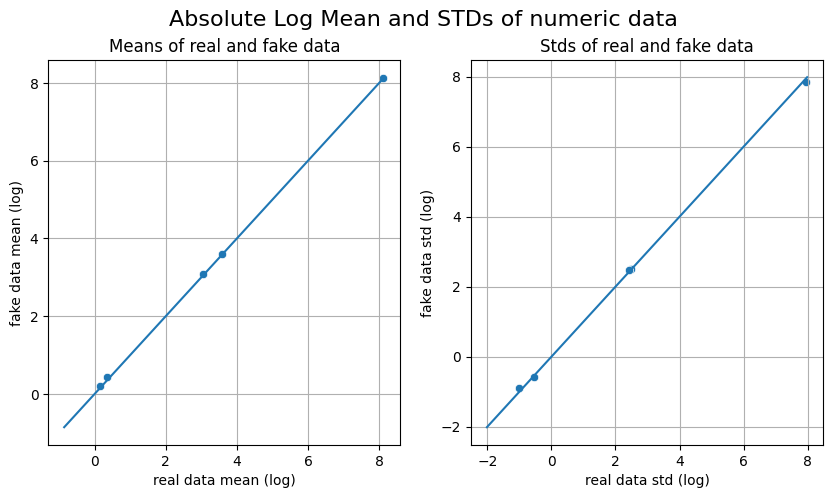

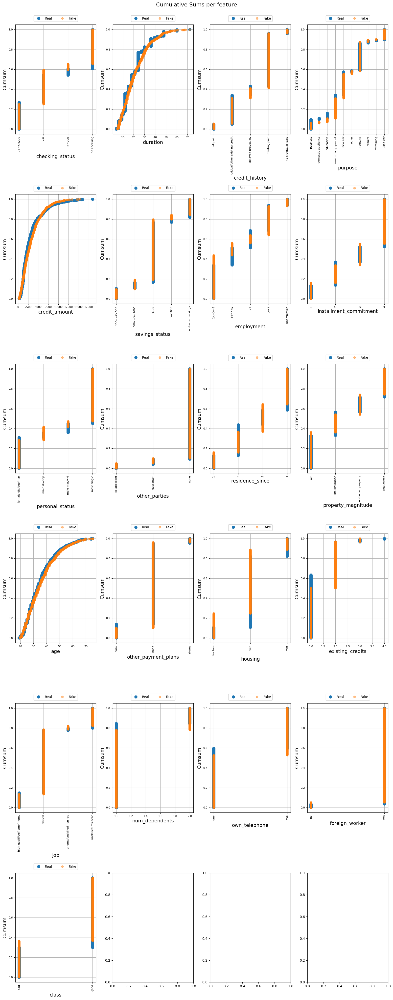

C:\Users\arnab\AppData\Local\Programs\Python\Python310\lib\site-packages\table_evaluator\table_evaluator.py:156: FutureWarning:

The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\arnab\AppData\Local\Programs\Python\Python310\lib\site-packages\table_evaluator\table_evaluator.py:156: FutureWarning:

The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\arnab\AppData\Local\Programs\Python\Python310\lib\site-packages\table_evaluator\table_evaluator.py:156: FutureWarning:

The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\arnab\AppData\Local\Programs\Python\Python310\lib\site-packages\table_evaluator\table_evaluator.py:156: FutureWarning:

The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\U

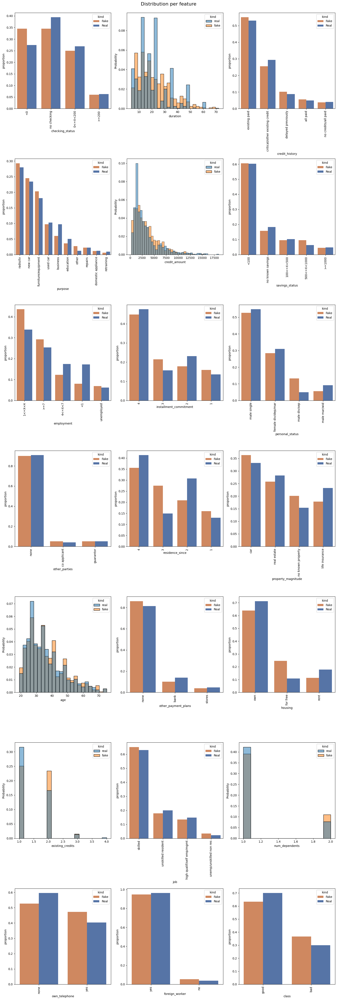

TypeError: Image data of dtype object cannot be converted to float

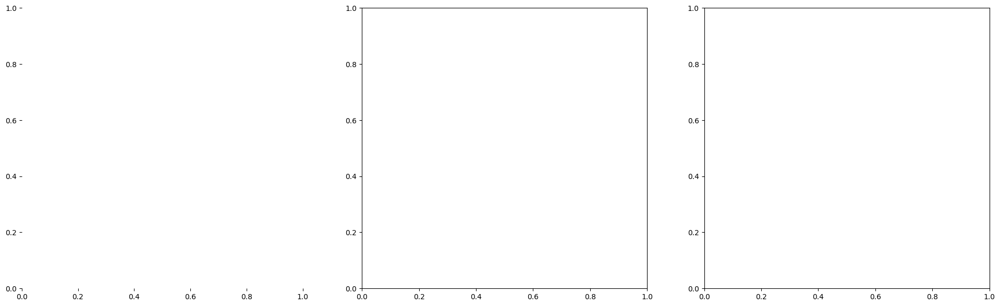

In [182]:
from table_evaluator import TableEvaluator
table_evaluator = TableEvaluator(real_data, reversed_dff, cat_cols=cat_cols)
table_evaluator.visual_evaluation()

In [183]:
fig=quality_report4.get_visualization(property_name='Column Pair Trends')
fig.show()

## Diagnostic Score

In [184]:
from sdmetrics.reports.single_table import DiagnosticReport

report4 = DiagnosticReport()

In [185]:
report4.generate(real_data, reversed_dff,metadata)

Creating report: 100%|███████████████████████████████████████████████████████████████████| 4/4 [00:25<00:00,  6.34s/it]


DiagnosticResults:

SUCCESS:
✓ The synthetic data covers over 90% of the numerical ranges present in the real data
✓ The synthetic data covers over 90% of the categories present in the real data
✓ Over 90% of the synthetic rows are not copies of the real data
✓ The synthetic data follows over 90% of the min/max boundaries set by the real data


In [186]:
report4.get_properties()

{'Coverage': 0.9984493797519007, 'Synthesis': 1.0, 'Boundaries': 1.0}

In [187]:
from sdmetrics.single_table import GMLogLikelihood

GMLogLikelihood.compute(
    real_data=real_data,
    synthetic_data=reversed_dff
)

-260.9887124744173

In [188]:
#DETECTION
#DETECTION
from sdmetrics.single_table import LogisticDetection

LogisticDetection.compute(
    real_data=real_data,
    synthetic_data=reversed_dff,
    metadata=metadata
)

0.6301909166651682

In [189]:
from sdmetrics.single_table import BinaryAdaBoostClassifier, BinaryDecisionTreeClassifier, BinaryLogisticRegression, BinaryMLPClassifier    

#MLEFFICACY
BinaryLogisticRegression.compute(
    test_data=real_data,
    train_data=reversed_dff,
    target='class',
    metadata=metadata
)

0.6951124903025602

In [ ]:
#PRIVACY
from sdmetrics.single_table import CategoricalZeroCAP
score = CategoricalZeroCAP.compute(
    real_data=real_data,
    synthetic_data=reversed_dff,
    key_fields=['purpose', 'class','personal_status'],
    sensitive_fields=['property_magnitude'])
score

In [190]:
table_evaluator.evaluate(target_col='class')

C:\Users\arnab\AppData\Local\Programs\Python\Python310\lib\site-packages\table_evaluator\metrics.py:95: FutureWarning:

iteritems is deprecated and will be removed in a future version. Use .items instead.




Classifier F1-scores and their Jaccard similarities::
                             f1_real  f1_fake  jaccard_similarity
index                                                            
DecisionTreeClassifier_fake   0.5650   0.5700              0.3746
DecisionTreeClassifier_real   0.6950   0.6450              0.4599
LogisticRegression_fake       0.6600   0.6900              0.5625
LogisticRegression_real       0.6850   0.6300              0.6327
MLPClassifier_fake            0.3900   0.6350              0.1204
MLPClassifier_real            0.3550   0.6400              0.0899
RandomForestClassifier_fake   0.6000   0.6100              0.4599
RandomForestClassifier_real   0.7400   0.6250              0.5686

Privacy results:
                                         result
Duplicate rows between sets (real/fake)  (0, 0)
nearest neighbor mean                    3.0635
nearest neighbor std                     0.4106

Miscellaneous results:
                                  Result
Column Cor

C:\Users\arnab\AppData\Local\Programs\Python\Python310\lib\site-packages\table_evaluator\metrics.py:121: FutureWarning:

iteritems is deprecated and will be removed in a future version. Use .items instead.



In [191]:
#CTGAN
table_evaluator1.evaluate(target_col='class')


Classifier F1-scores and their Jaccard similarities::
                             f1_real  f1_fake  jaccard_similarity
index                                                            
DecisionTreeClassifier_fake   0.5850   0.7350              0.4388
DecisionTreeClassifier_real   0.6550   0.6150              0.5152
LogisticRegression_fake       0.7300   0.8450              0.6327
LogisticRegression_real       0.7200   0.6950              0.6878
MLPClassifier_fake            0.8450   0.8500              0.9900
MLPClassifier_real            0.6400   0.6350              0.9704
RandomForestClassifier_fake   0.6750   0.8200              0.5326
RandomForestClassifier_real   0.7050   0.7100              0.6064

Privacy results:
                                         result
Duplicate rows between sets (real/fake)  (0, 0)
nearest neighbor mean                    3.0817
nearest neighbor std                     0.4595

Miscellaneous results:
                                  Result
Column Cor

C:\Users\arnab\AppData\Local\Programs\Python\Python310\lib\site-packages\table_evaluator\metrics.py:95: FutureWarning:

iteritems is deprecated and will be removed in a future version. Use .items instead.

C:\Users\arnab\AppData\Local\Programs\Python\Python310\lib\site-packages\table_evaluator\metrics.py:121: FutureWarning:

iteritems is deprecated and will be removed in a future version. Use .items instead.

